<a href="https://colab.research.google.com/github/EduardoBeitia11/StochasticProcesses/blob/main/Colemna.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [137]:
#Importing needed libraries
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from matplotlib.colors import ListedColormap, BoundaryNorm
from matplotlib import rc
from matplotlib.widgets import Button, Slider
import math
from IPython.display import HTML
plt.rcParams['animation.embed_limit'] = 2**128
from matplotlib.pyplot import subplots

In [145]:
#Input Data
seed=1
colonySize=50
termites=100
density=0.3
steps=1000

#ammount of Splinter
Splinter = int((colonySize*colonySize)*density)

print(Splinter)

#seed in np
np.random.seed(1)

#2D Array
colony = np.zeros((colonySize, colonySize), dtype = int)

#Check if position is already in use
usedPosition = []
neighborSplinter = []

#Plot variable
fig = plt.figure()
colors = ['black','yellow','white','orange']
cmap = plt.cm.colors.ListedColormap(colors)

#plot title variables
termitesWithSplinter = 0
termitesWithoutSplinter = 0

750


<Figure size 640x480 with 0 Axes>

In [146]:
#Splinter is 1 | Termites is 2 | Termites with Splinters is 3
SplinterCounter = 0
while SplinterCounter < Splinter:
  x = np.random.randint(0,colonySize)
  y = np.random.randint(0,colonySize)
  colony[x][y] = 1
  SplinterCounter +=1

print(SplinterCounter)


termitesCounter = 0
while termitesCounter < termites:
  x = np.random.randint(0,colonySize)
  y = np.random.randint(0,colonySize)
  if colony[x][y] == 1:
    colony[x][y] = 3
    termitesWithSplinter += 1
  else:
    colony[x][y] = 2
    termitesWithoutSplinter += 1
  termitesCounter +=1

print(termitesCounter)

750
100


In [147]:
def checkNeighbor(x, y, value):
  for neighborX in range(x-1,x+2):
    for neighborY in range(y-1,y+2):
      if neighborX >= 0 and y>=0 and neighborX < colonySize  and neighborY < colonySize:
          if neighborX != x or neighborY != y:
            if value == 2 and colony[neighborX][neighborY] == 1:
              neighborSplinter.append([neighborX,neighborY])
            elif value == 3 and colony[neighborX][neighborY] == 1:
              return True

  if len(neighborSplinter):
    return True
  
  return False


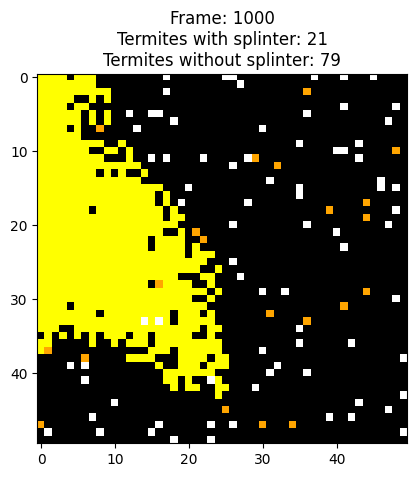

In [148]:
legend = ListedColormap(colors)    
fig, ax = subplots()
bounds = [0,1,2,3,4]
norm = BoundaryNorm(bounds,len(colors))
image = ax.imshow(colony, cmap=legend, norm=norm, interpolation='nearest')    
def init():
    # Perform any necessary initialization of the plot
    image.set_array(colony)
    #return [image]

def update(frame):
  global termitesWithSplinter, termitesWithoutSplinter
  for x in range(colonySize):
    for y in range(colonySize):
      if [x,y] not in usedPosition:
        #Check if the position in the colony has a termite with Splinter
        if colony[x][y] == 2:
          #Check for neighbors
          hasNeighbor = checkNeighbor(x,y,2)
          #If termite with no splinter has Splinter as neigbor on the 2d array
          if hasNeighbor:

            #Take a random Splinter and convert Splinter space to 0 
            SplinterToTake = np.random.randint(0,len(neighborSplinter))
            SplinterPositions = neighborSplinter[SplinterToTake]
            colony[SplinterPositions[0]][SplinterPositions[1]] = 0

            #Change from termite to termite with Splinter
            colony[x][y] = 3
            termitesWithSplinter += 1
            termitesWithoutSplinter -= 1

            #Clear neigborSplinter list
            neighborSplinter.clear()

          else:
            #Generate random position for termite (Termite only can jump to a random position with 0 as value)
            newX = np.random.randint(0,colonySize)
            newY = np.random.randint(0,colonySize)

            while colony[newX][newY] != 0:
              newX = np.random.randint(0,colonySize)
              newY = np.random.randint(0,colonySize)

            colony[x][y] = 0
            colony[newX][newY] = 2
            #UsedPosition is to make sure the termite won't move twice on a step
            usedPosition.append([newX, newY])

        elif colony[x][y] == 3:

          #Check for neighbors
          hasNeighbor = checkNeighbor(x,y,3)
          #If termite with splinter has Splinter as neigbor on the 2d array
          if hasNeighbor:
            #Leave the splinter in the current position and jump to a random position (Termite only can jump to a random position with 0 as value)
            colony[x][y] = 1
            newX = np.random.randint(0,colonySize)
            newY = np.random.randint(0,colonySize)
            while colony[newX][newY] != 0:
              newX = np.random.randint(0,colonySize)
              newY = np.random.randint(0,colonySize)
            
            colony[newX][newY] = 2
            termitesWithSplinter -= 1
            termitesWithoutSplinter += 1

            #UsedPosition is to make sure the termite won't move twice on a step
            usedPosition.append([newX, newY])

          else:
            #Generate random position for termite with splinter (Termite only can jump to a random position with 0 as value)
            newX = np.random.randint(0,colonySize)
            newY = np.random.randint(0,colonySize)
            while colony[newX][newY] != 0:
              newX = np.random.randint(0,colonySize)
              newY = np.random.randint(0,colonySize)
            
            colony[x][y] = 0
            colony[newX][newY] = 3

            #UsedPosition is to make sure the termite won't move twice on a step
            usedPosition.append([newX, newY])

  usedPosition.clear()
  image.set_array(colony)
  plt.title("Frame: " + str(frame + 1) + "\nTermites with splinter: " +
              str(termitesWithSplinter) + "\nTermites without splinter: " +
              str(termitesWithoutSplinter))
  return [image]
##end of update function

def play_animation(event):
    global current_frame
    ani.event_source.start()

def pause_animation(event):
    global current_frame
    ani.event_source.stop()

def update_frame(val):
    global current_frame
    current_frame = int(val)
    update(current_frame)

ani = animation.FuncAnimation(fig, update, frames=steps, init_func=init, blit=False, repeat=False, interval=200)

HTML(ani.to_jshtml())


1. La razon por que la que la estrategia no es contra producente y terminan
siendo apiladas las astillas es porque el comportamiento de las termitas solo 
permite que ellas recolecten las astillas que estan en las afueras de la pila 
de astillas que se van formando.

2. Los montones disminuten porque por el comportamiento de las termitas todo llega a convertirse en un solo monton. No se puede empezar otro monton porque el centro del monton dominante ayuda a que las astillas siempre regresen a sus bordes.

3. El porceso estocastico es el de Random Walk ya que este proceso habla de sus actuadores que toman procesos aleatoria independientes.

4. No cambiaria el resultado si fuera una sola termita. Tomaria mas tiempo llevar a cabo una solo pila de astillas pero el resultado seria el mismo.

5. La prioridad de apilar astillas siempre la tendran los montones con mas astillas accesibles en sus bordes.